In [1]:
from IPython.display import Audio
import numpy as np
import matplotlib.pyplot as plt
import librosa
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torchsummary import summary
from preprocessing.transform import save_stft, process_stft
from preprocessing.data import DSD100, dataloader, data_split
from model.network import UNet
from model.train_model import train

# PREPROCESSING

In [3]:
song_path = "data/DSD100/mixtures/train/063 - Detsky Sad - Walkie Talkie/mixture.wav"
# Load song
audio_arr, sr = librosa.load(song_path, sr=8192)
audio_arr.shape

(1560430,)

In [4]:
# Audio play
Audio(audio_arr, rate=sr)

In [5]:
audio_stft = librosa.stft(audio_arr, n_fft=1024, hop_length=768)
audio_stft.shape

(513, 2032)

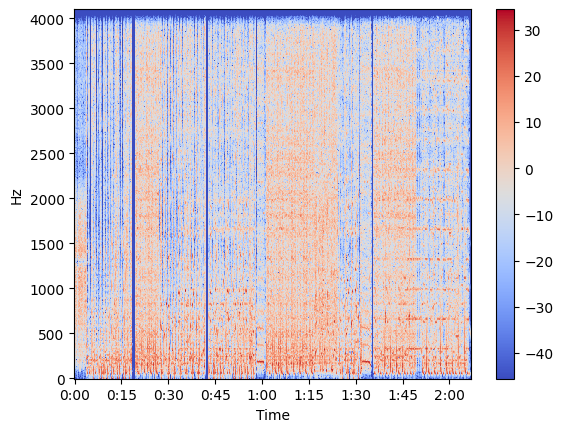

In [6]:
audio_stft_db = librosa.amplitude_to_db(np.abs(audio_stft))
librosa.display.specshow(audio_stft_db, sr=sr, x_axis="time", y_axis="hz")
plt.colorbar()
plt.show()

In [7]:
# Normalize STFT between [0,1]
audio_stft = (np.abs(audio_stft) - np.min(np.abs(audio_stft))) / (
    np.max(np.abs(audio_stft)) - np.min(np.abs(audio_stft))
)

In [8]:
# Select STFT of size (512, 128)
audio = librosa.istft(audio_stft[:, :128], hop_length=768, n_fft=1024)
audio_stft[:, :128].shape

(513, 128)

In [9]:
%find ./data -name '.DS_Store' -type f -delete

UsageError: Line magic function `%find` not found.


In [10]:
# Convert to spectrogram and save in .npz file
dataset_path = "data/DSD100"

mixture_path = dataset_path + "/" + sorted(os.listdir(dataset_path))[0]
sources_path = dataset_path + "/" + sorted(os.listdir(dataset_path))[1]

train_path = sources_path + "/" + sorted(os.listdir(mixture_path))[0]
val_path = sources_path + "/" + sorted(os.listdir(mixture_path))[1]

sorted(os.listdir(sources_path))

['train', 'val']

In [26]:
dataset_path = "data/DSD100"
save_path = "data/DSD100_spectrogram"

save_stft(dataset_path, save_path)

051 - AM Contra - Heart Peripheral
052 - ANiMAL - Easy Tiger
053 - Actions - Devils Words
054 - Actions - South Of The Water
055 - Angels In Amplifiers - Im Alright
056 - Arise - Run Run Run
057 - BKS - Bulldozer
058 - Ben Carrigan - Well Talk About It All Tonight
059 - Black Bloc - If You Want Success
060 - Buitraker - Revo X
061 - Chris Durban - Celebrate
062 - Cristina Vane - So Easy
063 - Detsky Sad - Walkie Talkie
064 - Enda Reilly - Cur An Long Ag Seol
065 - Fergessen - Nos Palpitants
066 - Flags - 54
067 - Georgia Wonder - Siren
068 - Giselle - Moss
069 - Hollow Ground - Left Blind
070 - James May - All Souls Moon
071 - James May - If You Say
072 - Jay Menon - Through My Eyes
073 - Johnny Lokke - Whisper To A Scream
074 - Juliets Rescue - Heartbeats
075 - Leaf - Summerghost
076 - Little Chicagos Finest - My Own
077 - Lyndsey Ollard - Catching Up
078 - Moosmusic - Big Dummy Shake
079 - Mu - Too Bright
080 - North To Alaska - All The Same
081 - Patrick Talbot - Set Me Free
082 - P

# TRAINING

In [27]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [28]:
dataset = DSD100("data/DSD100_spectrogram")

for mixture, bass, drum, vocal, instrumental in dataset:
    print(mixture.shape)
    print(bass.shape)
    print(drum.shape)
    print(vocal.shape)
    print(instrumental.shape)
    break

torch.Size([1, 511, 127])
torch.Size([1, 511, 127])
torch.Size([1, 511, 127])
torch.Size([1, 511, 127])
torch.Size([1, 511, 127])


In [29]:
len(dataset)

13225

In [30]:
train_dataset, val_dataset = data_split(dataset, 0.7)
len(train_dataset), len(val_dataset)

(9258, 3967)

In [31]:
train_dataloader = dataloader(train_dataset, 16, shuffle=True)
val_dataloader = dataloader(val_dataset, 16, shuffle=False)

for mixture, bass, drum, vocal, instrumental in train_dataloader:
    print(mixture.shape)
    print(bass.shape)
    print(drum.shape)
    print(vocal.shape)
    print(instrumental.shape)
    break

torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])


In [32]:
model = UNet()

summary(model.to(device), input_size=(1, 511, 127), batch_size=16)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [16, 16, 255, 63]             416
       BatchNorm2d-2          [16, 16, 255, 63]              32
         LeakyReLU-3          [16, 16, 255, 63]               0
           encoder-4          [16, 16, 255, 63]               0
            Conv2d-5          [16, 32, 127, 31]          12,832
       BatchNorm2d-6          [16, 32, 127, 31]              64
         LeakyReLU-7          [16, 32, 127, 31]               0
           encoder-8          [16, 32, 127, 31]               0
            Conv2d-9           [16, 64, 63, 15]          51,264
      BatchNorm2d-10           [16, 64, 63, 15]             128
        LeakyReLU-11           [16, 64, 63, 15]               0
          encoder-12           [16, 64, 63, 15]               0
           Conv2d-13           [16, 128, 31, 7]         204,928
      BatchNorm2d-14           [16, 128

Loss function

- use L1 loss(MAE) as loss function
- use euclidean distance as evaluation metrices

In [33]:
optimizer = Adam(model.parameters())
loss_fn = nn.L1Loss()

def euclidean_distace(true_value, predicted_value):
    return torch.sqrt(torch.sum(torch.square(true_value - predicted_value)))

In [35]:
# Train VOCAL
history = train(
    model,
    train_dataloader,
    val_dataloader,
    "./model/save",
    stem_name="vocal",
    epoch=5,
    learning_rate=0.001,
)

100%|██████████| 248/248 [02:47<00:00,  1.48it/s, train_euclidean_distance=410, train_loss=0.112, val_euclidean_distance=426, val_loss=0.114]


In [47]:
# Train DRUM
history = train(
    model,
    train_dataloader,
    val_dataloader,
    "./model/save",
    stem_name="drum",
    epoch=5,
    learning_rate=0.001,
)

100%|██████████| 248/248 [02:43<00:00,  1.52it/s, train_euclidean_distance=444, train_loss=0.123, val_euclidean_distance=449, val_loss=0.124]


In [48]:
# Train BASS
history = train(
    model,
    train_dataloader,
    val_dataloader,
    "./model/save",
    stem_name="bass",
    epoch=5,
    learning_rate=0.001,
)

100%|██████████| 248/248 [02:17<00:00,  1.81it/s, train_euclidean_distance=437, train_loss=0.0758, val_euclidean_distance=442, val_loss=0.0772]


In [50]:
# Train OTHER
history = train(
    model,
    train_dataloader,
    val_dataloader,
    "./model/save",
    stem_name="instrumental",
    epoch=5,
    learning_rate=0.001,
)

100%|██████████| 248/248 [03:07<00:00,  1.33it/s, train_euclidean_distance=370, train_loss=0.115, val_euclidean_distance=374, val_loss=0.112]



# Predict Demo

### Vocal

In [36]:
device = torch.device("cpu")

In [38]:
audio_array, sr = librosa.load(
    "data/DSD100/mixtures/val/046 - Triviul - Dorothy/mixture.wav"
)

Audio(audio_array, rate=sr)

In [39]:
audio_stft = librosa.stft(audio_array, n_fft=1024, hop_length=768)
audio_stft.shape

(513, 5385)

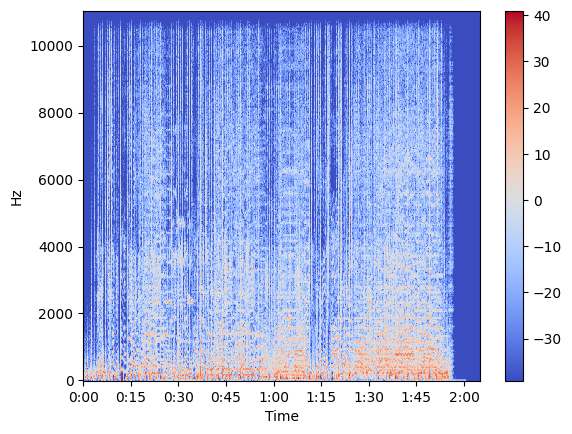

In [40]:
audio_stft_db = librosa.amplitude_to_db(np.abs(audio_stft))
librosa.display.specshow(audio_stft_db, sr=sr, x_axis="time", y_axis="hz")
plt.colorbar()
plt.show()

In [41]:
# Inverse STFT
# audio_inv_stft = librosa.istft(
#     (
#         audio_stft[
#             :511,
#         ]
#     ),
#     n_fft=1024,
#     hop_length=768,
# )


In [43]:
stem = "vocal"
vocal_model = torch.load(f"./model/save/{stem}_best_model.pt", map_location=device)

In [44]:
# Function !!
# total_frame = audio_stft.shape[1] // 127 + 1
# done_frame = 0
# vocal_model.eval()
# for i in range(0, audio_stft.shape[1], 127):
#     mixture = np.abs(audio_stft[:511, i : i + 127])
#     col_num = mixture.shape[1]
#     if col_num != 127:
#         mixture = np.concatenate(
#             (mixture, np.zeros(shape=(511, 127 - col_num))), axis=1
#         )

#     mixture = torch.from_numpy(mixture[np.newaxis, np.newaxis, :, :]).to(device)
#     input = dataloader(mixture.to(torch.float32), batch_size=1)
#     with torch.no_grad():
#         for x in input:
#             # print(x.shape)
#             y = vocal_model(x)
#             if i == 0:
#                 output = y[0][0]
#             else:
#                 if col_num == 127:
#                     output = torch.cat([output, y[0][0]], dim=1)
#                 else:
#                     output = torch.cat([output, y[0][0][:, :col_num]], dim=1)
#     done_frame += 1
#     print(f"{done_frame}/{total_frame}")

1/43
2/43
3/43
4/43
5/43
6/43
7/43
8/43
9/43
10/43
11/43
12/43
13/43
14/43
15/43
16/43
17/43
18/43
19/43
20/43
21/43
22/43
23/43
24/43
25/43
26/43
27/43
28/43
29/43
30/43
31/43
32/43
33/43
34/43
35/43
36/43
37/43
38/43
39/43
40/43
41/43
42/43
43/43


In [45]:
output = (process_stft(audio_stft, vocal_model).to(torch.device("cpu"))).numpy()
print(audio_stft[:511, :].shape)
print(output.shape)

(511, 5385)
(511, 5385)


In [46]:
output = np.multiply(audio_stft[:511, :], output)

audio_output = librosa.istft(output, n_fft=1024, hop_length=768)
Audio(audio_output, rate=sr)

### Drum